In [17]:
import cv2 
import numpy as np
import random
import matplotlib.pyplot as plt 
%matplotlib inline

1. Hue

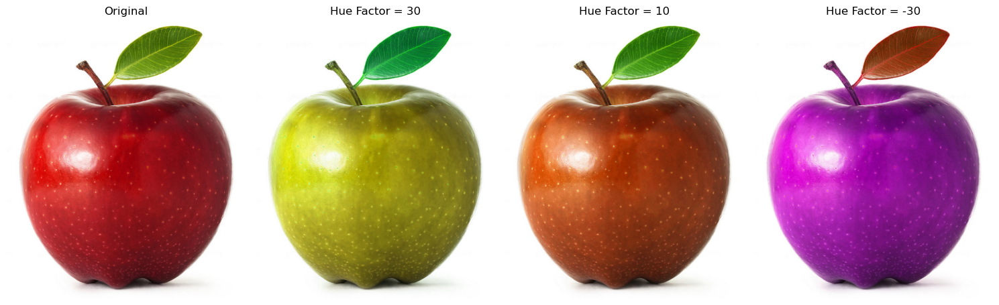

Processed image: apple_81.jpg


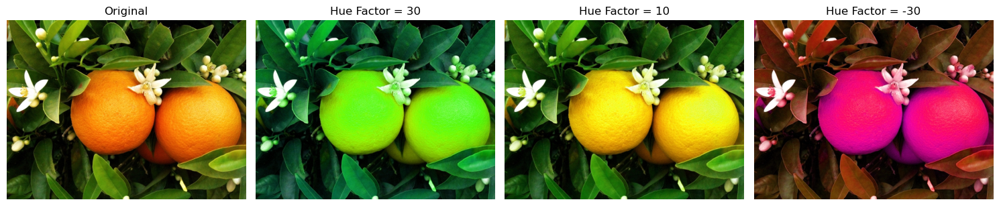

Processed image: orange_34.jpg


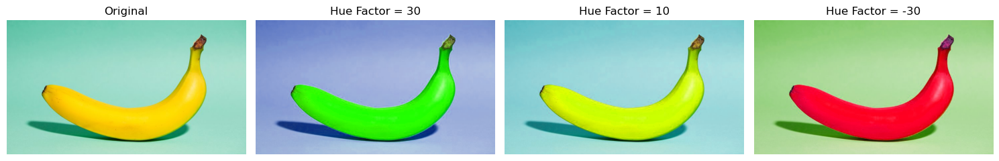

Processed image: banana_1.jpg
Hue adjustment on all images complete


In [4]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def adjust_hue(img, hue_factor):
    """
    Adjust the hue of an image
    :param image: Input image
    :param hue_factor: Hue adjustment factor, 0 means no adjustment,
                      negative values rotate counterclockwise, positive values rotate clockwise
    :return: Adjusted image
    """
    hsv_image = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    hsv_image[..., 0] = (hsv_image[..., 0] + hue_factor) % 180
    img = cv2.cvtColor(hsv_image, cv2.COLOR_HSV2BGR)
    return img

# List of image files
img_files = ["apple_81.jpg", "orange_34.jpg", "banana_1.jpg"]

hue_factors = [30, 10, -30]  # Hue adjustment factors

# Iterate over each image file
for i, img_file in enumerate(img_files):
    img = cv2.imread(img_file)
    hue_adjusted_imgs = []
    
    # Apply hue adjustment for different hue factors
    for hue_factor in hue_factors:
        hue_adjusted_img = adjust_hue(img.copy(), hue_factor)
        hue_adjusted_imgs.append(hue_adjusted_img)

    # Display the hue adjusted images
    fig, axes = plt.subplots(1, len(hue_factors) + 1, figsize=(15, 5))
    axes[0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    axes[0].set_title("Original")
    axes[0].axis('off')

    for j, hue_adjusted_img in enumerate(hue_adjusted_imgs, start=1):
        axes[j].imshow(cv2.cvtColor(hue_adjusted_img, cv2.COLOR_BGR2RGB))
        
        # Modify the title for displayed images
        axes[j].set_title(f"Hue Factor = {hue_factors[j-1]}")
        
        axes[j].axis('off')
        
        # Save the hue adjusted images
        output_filename = f"hue_adjusted_{img_file}_image{j}.jpg"
        cv2.imwrite(output_filename, hue_adjusted_img)

    plt.tight_layout()
    plt.show()

    print(f"Processed image: {img_file}")
    
print('Hue adjustment on all images complete')


2. brightless

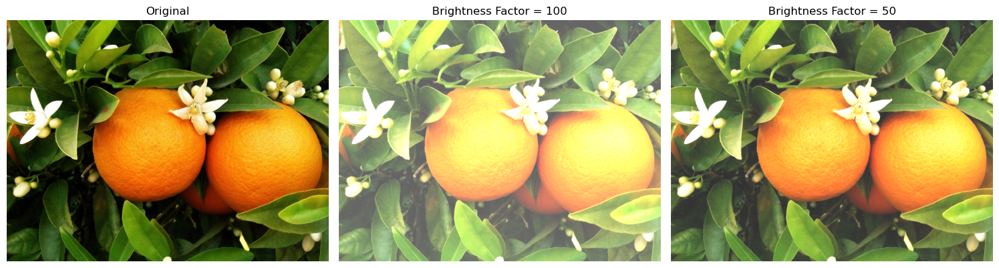

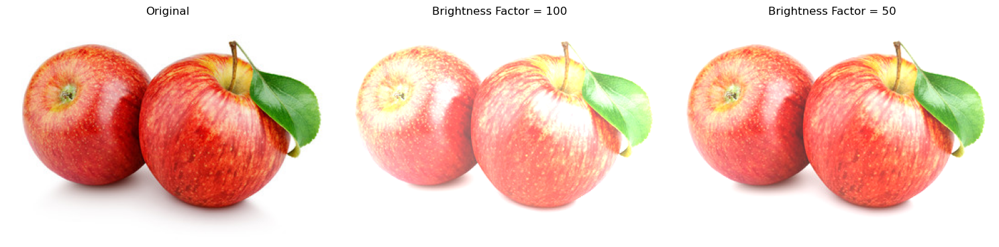

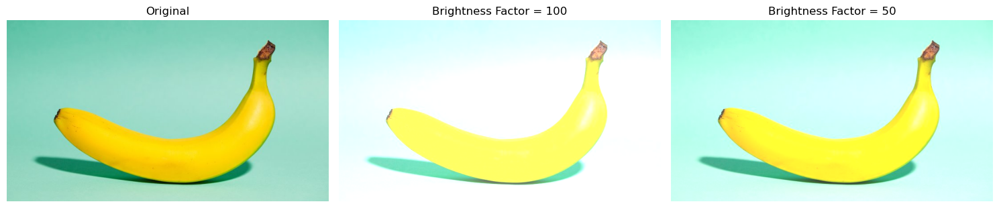

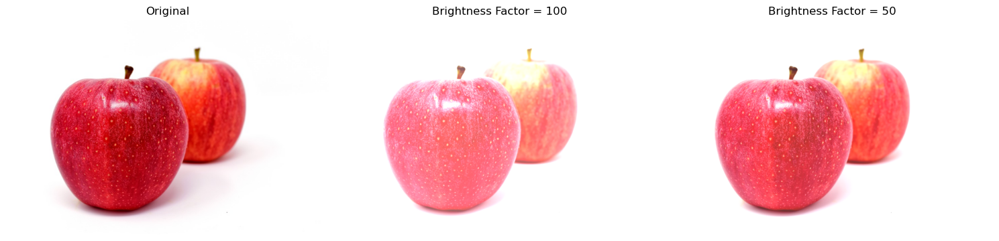

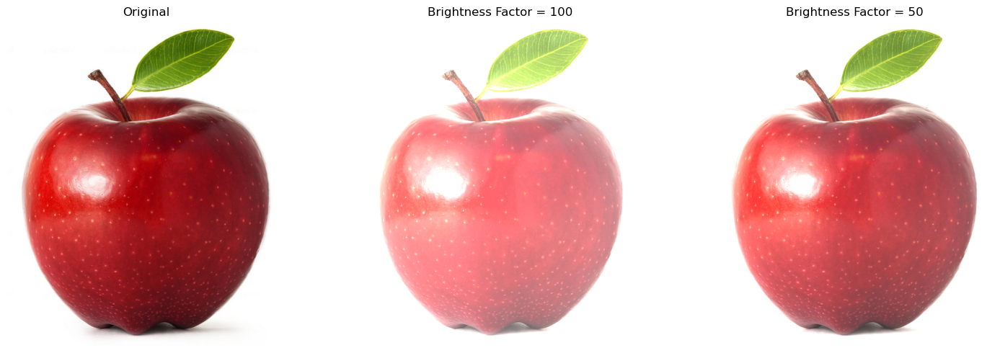

In [6]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

def adjust_brightness(image, beta):
    """
    Adjust the brightness of an image (illumination)
    :param image: Input image
    :param beta: Brightness adjustment factor, 0 means no adjustment,
                 positive values increase brightness, negative values decrease brightness
    :return: Adjusted image
    """
    img = cv2.convertScaleAbs(image, alpha=1, beta=beta)
    return img

# List of image files
img_files = ["orange_34.jpg", "apple_4.jpg", "banana_1.jpg","apple_48.jpg", "apple_81.jpg"]

# Brightness adjustment factors for each image
brightness_factors = [100, 50]

# Iterate over each image file
for idx, img_file in enumerate(img_files):
    original_image = cv2.imread(img_file)
    adjusted_images = []

    # Apply brightness adjustment for different factors
    for factor in brightness_factors:
        adjusted_image = adjust_brightness(original_image.copy(), beta=factor)
        adjusted_images.append(adjusted_image)

    # Display and save the processed images
    fig, axes = plt.subplots(1, len(brightness_factors) + 1, figsize=(15, 5))
    axes[0].imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))
    axes[0].set_title("Original")
    axes[0].axis('off')

    for i, adjusted_image in enumerate(adjusted_images, start=1):
        axes[i].imshow(cv2.cvtColor(adjusted_image, cv2.COLOR_BGR2RGB))
        axes[i].set_title(f"Brightness Factor = {brightness_factors[i-1]}")
        axes[i].axis('off')

        # Save the adjusted images
        output_filename = f"adjusted_{img_file[:-4]}_factor{i}.jpg"
        cv2.imwrite(output_filename, adjusted_image)

    plt.tight_layout()
    plt.show()


3. Saturation

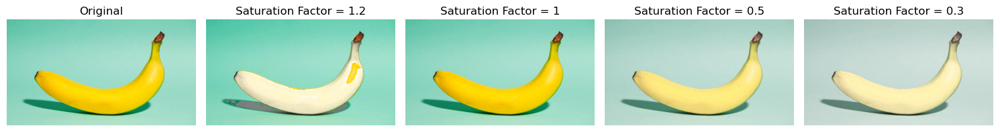

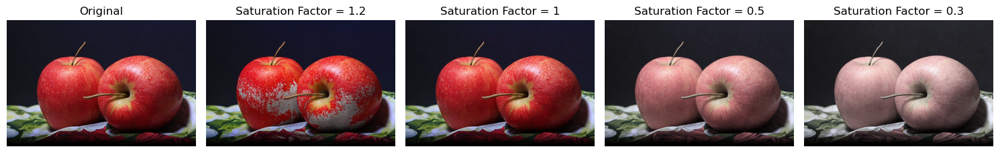

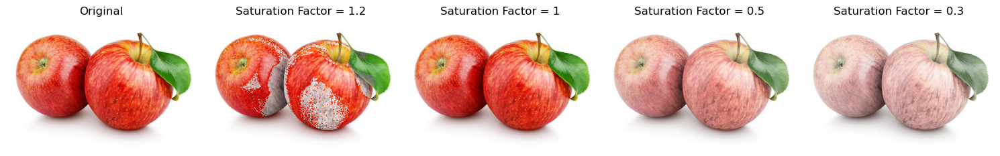

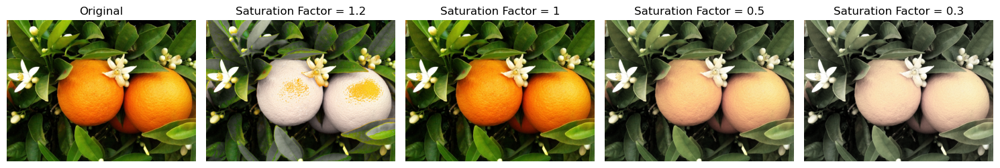

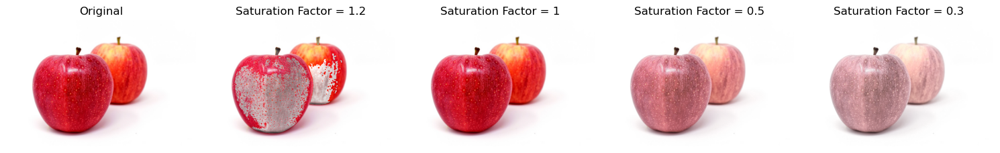

In [7]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

def adjust_saturation(image, saturation_factor):
    """
    Adjust the saturation of an image
    :param image: Input image
    :param saturation_factor: Saturation adjustment factor, 1 means no adjustment,
                             less than 1 decreases saturation, greater than 1 increases saturation
    :return: Adjusted image
    """
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    hsv_image[..., 1] = hsv_image[..., 1] * saturation_factor
    img = cv2.cvtColor(hsv_image, cv2.COLOR_HSV2BGR)
    return img

# List of image files
img_files = ["banana_1.jpg", "apple_21.jpg", "apple_4.jpg", "orange_34.jpg","apple_48.jpg" ]

# Saturation factors for adjustment
saturation_factors = [1.2, 1, 0.5, 0.3]

# Iterate over each image file
for img_file in img_files:
    img = cv2.imread(img_file)
    saturation_adjusted_imgs = []
    
    # Apply saturation adjustment for different factors
    for factor in saturation_factors:
        saturation_adjusted_img = adjust_saturation(img.copy(), saturation_factor=factor)
        saturation_adjusted_imgs.append(saturation_adjusted_img)

    # Display the processed images
    fig, axes = plt.subplots(1, len(saturation_factors) + 1, figsize=(15, 5))
    axes[0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    axes[0].set_title("Original")
    axes[0].axis('off')

    for i, adjusted_img in enumerate(saturation_adjusted_imgs, start=1):
        axes[i].imshow(cv2.cvtColor(adjusted_img, cv2.COLOR_BGR2RGB))
        
        # Modify the title for displayed images
        axes[i].set_title(f"Saturation Factor = {saturation_factors[i-1]}")
        
        axes[i].axis('off')
        
        # Save the adjusted images
        output_filename = f"saturation_adjusted_{img_file}_factor{i}.jpg"
        cv2.imwrite(output_filename, adjusted_img)

    plt.tight_layout()
    plt.show()


4. Add noise

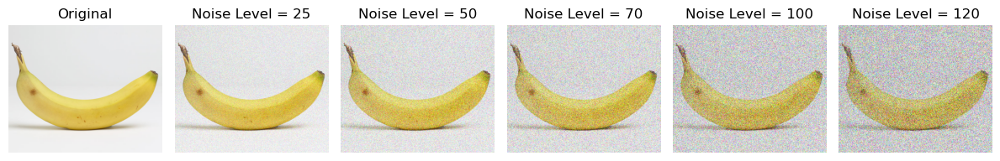

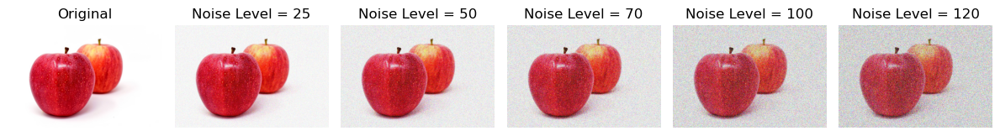

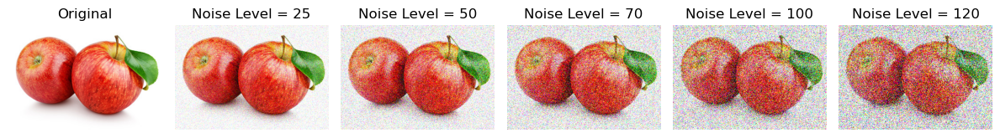

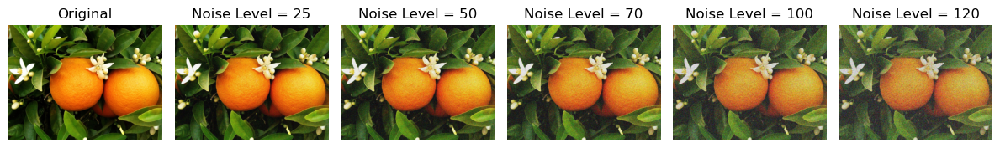

In [8]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def add_gaussian_noise(image, mean=0, std=25):
    """
    Add Gaussian noise to an image.
    :param image: Input image.
    :param mean: Mean of the noise.
    :param std: Standard deviation of the noise.
    :return: Noisy image.
    """
    h, w, c = image.shape
    noise = np.random.normal(mean, std, (h, w, c))
    noisy_image = image + noise
    noisy_image = np.clip(noisy_image, 0, 255).astype(np.uint8)
    return noisy_image

# List of image files
img_files = ["banana_38.jpg", "apple_48.jpg", "apple_4.jpg", "orange_34.jpg"]
# Noise levels for adjustment
noise_levels = [25, 50, 70, 100, 120]

# Iterate over each image file
for img_file in img_files:
    img = cv2.imread(img_file)
    
    # Initialize a list to store noisy images
    noisy_images = []
    
    # Add Gaussian noise for different levels
    for level in noise_levels:
        noisy_img = add_gaussian_noise(img.copy(), mean=0, std=level)
        noisy_images.append(noisy_img)

    # Display and save the processed images
    plt.figure(figsize=(12, 4))
    plt.subplot(1, len(noise_levels) + 1, 1)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title("Original")
    plt.axis('off')

    for i, noisy_img in enumerate(noisy_images, start=1):
        plt.subplot(1, len(noise_levels) + 1, i + 1)
        plt.imshow(cv2.cvtColor(noisy_img, cv2.COLOR_BGR2RGB))
        plt.title(f"Noise Level = {noise_levels[i-1]}")
        plt.axis('off')
        
        # Save the noisy images
        output_filename = f"noisy_{img_file[:-4]}_level{i}.jpg"
        cv2.imwrite(output_filename, noisy_img)

    plt.tight_layout()
    plt.show()


5. Contrast

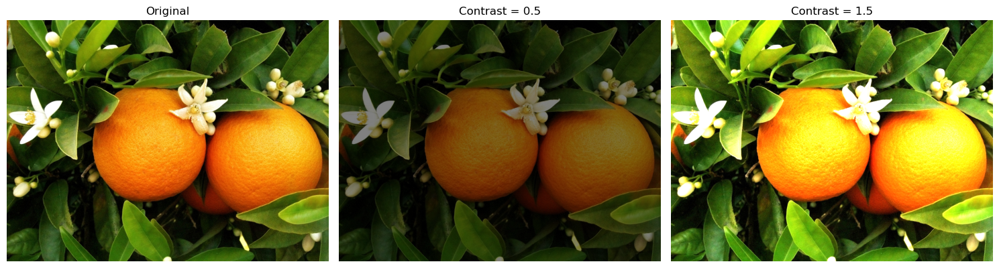

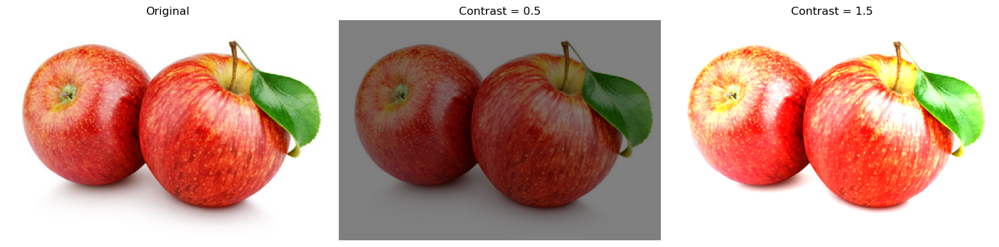

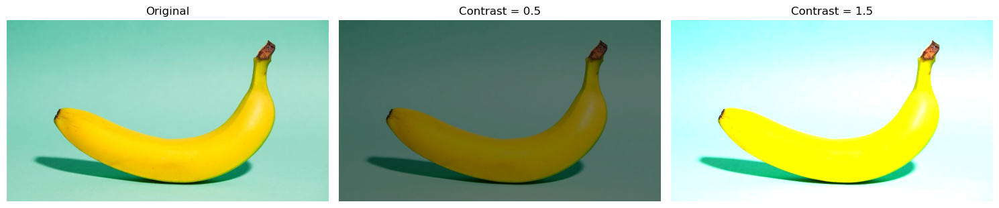

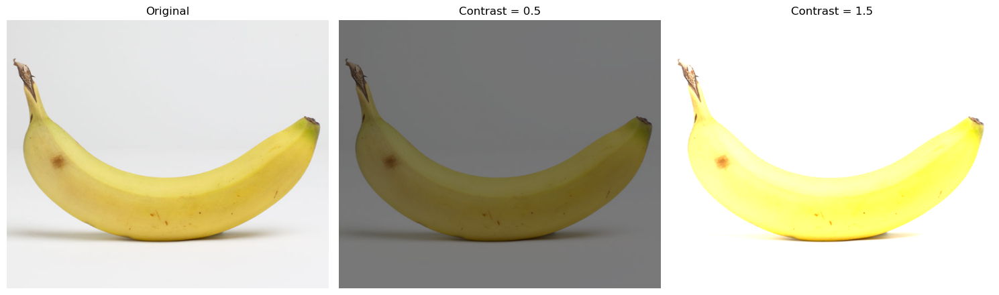

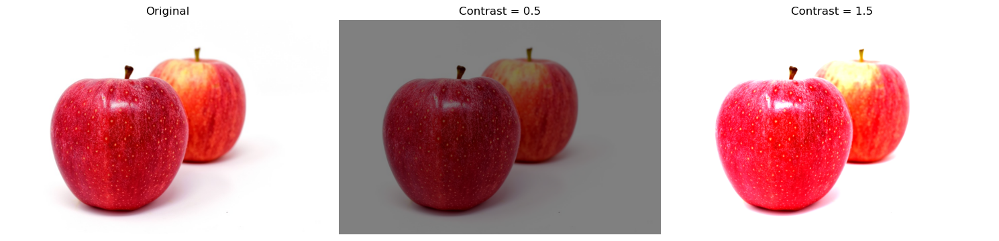

In [9]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

def adjust_contrast(image, alpha):
    """
    Adjust the contrast of an image
    :param image: Input image
    :param alpha: Contrast adjustment factor, 1 means no adjustment,
                  less than 1 decreases contrast, greater than 1 increases contrast
    :return: Adjusted image
    """
    adjusted_img = cv2.convertScaleAbs(image, alpha=alpha, beta=0)
    return adjusted_img

# List of image files
img_files = ["orange_34.jpg", "apple_4.jpg", "banana_1.jpg", "banana_38.jpg", "apple_48.jpg"]

# Parameters for contrast adjustment for each image
contrast_factors = [0.5, 1.5]

# Iterate over each image file
for idx, img_file in enumerate(img_files):
    original_image = cv2.imread(img_file)
    adjusted_images = []

    # Apply contrast adjustment for different factors
    for alpha in contrast_factors:
        adjusted_image = adjust_contrast(original_image.copy(), alpha=alpha)
        adjusted_images.append(adjusted_image)

    # Display and save the processed images
    fig, axes = plt.subplots(1, len(adjusted_images) + 1, figsize=(15, 5))
    axes[0].imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))
    axes[0].set_title("Original")
    axes[0].axis('off')

    for i, adjusted_image in enumerate(adjusted_images, start=1):
        axes[i].imshow(cv2.cvtColor(adjusted_image, cv2.COLOR_BGR2RGB))
        axes[i].set_title(f"Contrast = {contrast_factors[i-1]}")
        axes[i].axis('off')

        # Save the adjusted images
        output_filename = f"adjusted_contrast_{img_file[:-4]}_factor{i}.jpg"
        cv2.imwrite(output_filename, adjusted_image)

    plt.tight_layout()
    plt.show()


6. Mosaic

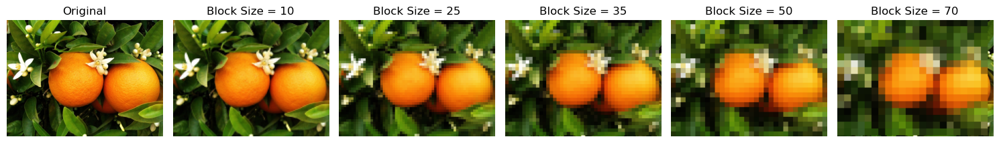

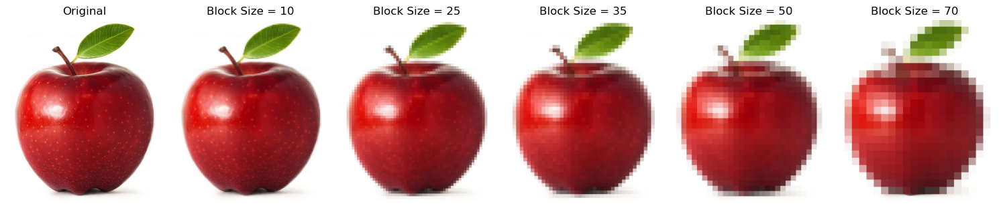

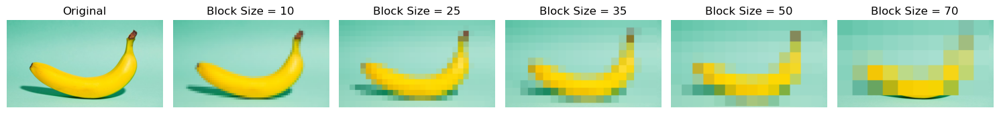

In [12]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

def mosaic(img, block_size):
    h, w = img.shape[:2]
    block_w = w // block_size
    block_h = h // block_size

    for y in range(block_h):
        for x in range(block_w):
            roi = img[y * block_size:(y + 1) * block_size, x * block_size:(x + 1) * block_size]
            mean_color = roi.mean(axis=(0, 1), dtype=int)
            img[y * block_size:(y + 1) * block_size, x * block_size:(x + 1) * block_size] = mean_color

    return img

# List of image files
img_files = ["orange_34.jpg", "apple_81.jpg", "banana_1.jpg"]

block_sizes = [10, 25, 35, 50, 70]

# Iterate over each image file
for img_file in img_files:
    img = cv2.imread(img_file)
    mosaic_imgs = []
    
    # Apply mosaic effect for different block sizes
    for block_size in block_sizes:
        mosaic_img = mosaic(img.copy(), block_size)
        mosaic_imgs.append(mosaic_img)

    # Display the processed images
    fig, axes = plt.subplots(1, len(block_sizes) + 1, figsize=(15, 5))
    axes[0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    axes[0].set_title("Original")
    axes[0].axis('off')

    for i, mosaic_img in enumerate(mosaic_imgs, start=1):
        axes[i].imshow(cv2.cvtColor(mosaic_img, cv2.COLOR_BGR2RGB))
        
        # Modify the title for displayed images
        axes[i].set_title(f"Block Size = {block_sizes[i-1]}")
        
        axes[i].axis('off')
        
        # Save the mosaic images
        output_filename = f"mosaic_{img_file}_image{i}.jpg"
        cv2.imwrite(output_filename, mosaic_img)

    plt.tight_layout()
    plt.show()


7. Blur

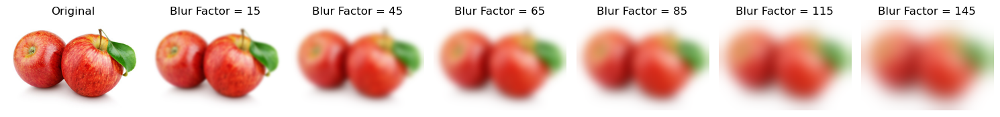

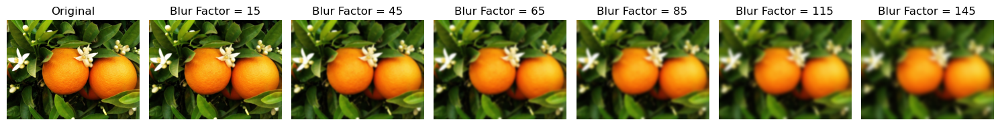

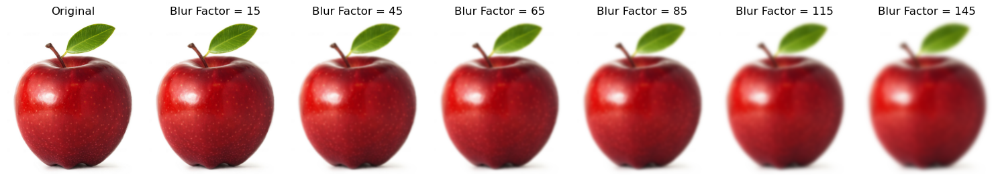

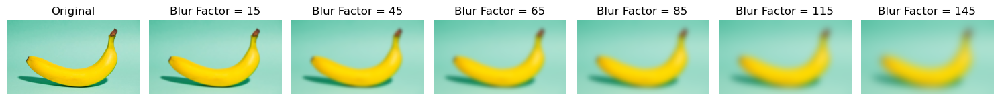

In [21]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

def apply_blur(image, blur_factor):
    """
    Apply Gaussian blur to an image
    :param image: Input image
    :param blur_factor: Blurring strength, larger values result in more noticeable blur
    :return: Blurred image
    """
    img = cv2.GaussianBlur(image, (blur_factor, blur_factor), 0)
    return img

# List of image files
img_files = ["apple_4.jpg", "orange_34.jpg","apple_81.jpg", "banana_1.jpg"]


# Blur factors for adjustment
blur_factors = [15, 45, 65, 85, 115, 145]

# Iterate over each image file
for img_file in img_files:
    img = cv2.imread(img_file)
    blurred_imgs = []
    
    # Apply Gaussian blur for different factors
    for factor in blur_factors:
        blurred_img = apply_blur(img.copy(), blur_factor=factor)
        blurred_imgs.append(blurred_img)

    # Display the processed images
    fig, axes = plt.subplots(1, len(blur_factors) + 1, figsize=(15, 5))
    axes[0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    axes[0].set_title("Original")
    axes[0].axis('off')

    for i, blurred_img in enumerate(blurred_imgs, start=1):
        axes[i].imshow(cv2.cvtColor(blurred_img, cv2.COLOR_BGR2RGB))
        
        # Modify the title for displayed images
        axes[i].set_title(f"Blur Factor = {blur_factors[i-1]}")
        
        axes[i].axis('off')
        
        # Save the blurred images
        output_filename = f"blurred_{img_file}_factor{i}.jpg"
        cv2.imwrite(output_filename, blurred_img)

    plt.tight_layout()
    plt.show()


8. Translation

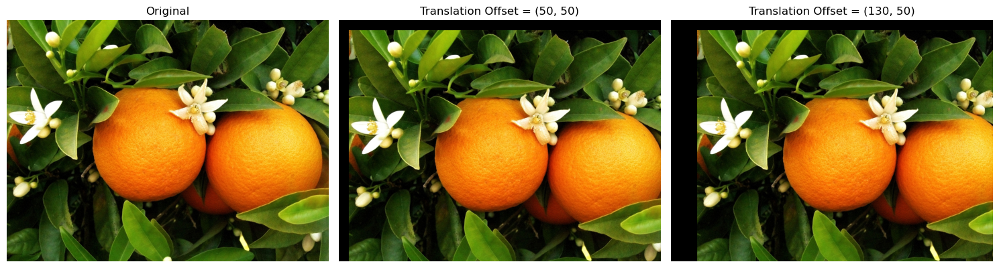

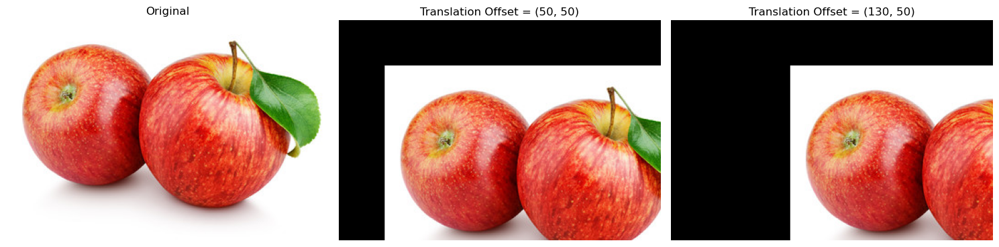

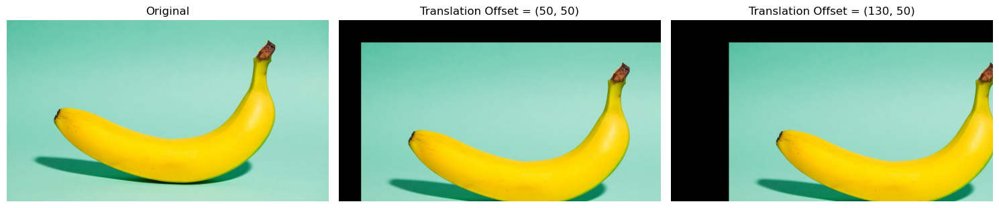

In [25]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def translate_image(image, dx, dy):
     """
    Translate an image
    :param image: Input image
    :param dx: Translation amount in the x direction
    :param dy: Translation amount in the y direction
    :return: Translated image
    """
    rows, cols, _ = image.shape
    M = np.float32([[1, 0, dx], [0, 1, dy]])
    translated_image = cv2.warpAffine(image, M, (cols, rows))
    return translated_image

# List of image files
img_files = ["orange_34.jpg", "apple_4.jpg", "banana_1.jpg"]

# Translation parameters for each image
translation_offsets = [(50, 50), (130, 50)]

# Iterate over each image file
for idx, img_file in enumerate(img_files):
    original_image = cv2.imread(img_file)
    translated_images = []

    # Apply translation for different offsets
    for dx, dy in translation_offsets:
        translated_image = translate_image(original_image.copy(), dx=dx, dy=dy)
        translated_images.append(translated_image)

    # Display and save the processed images
    fig, axes = plt.subplots(1, len(translated_images) + 1, figsize=(15, 5))
    axes[0].imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))
    axes[0].set_title("Original")
    axes[0].axis('off')

    for i, translated_image in enumerate(translated_images, start=1):
        axes[i].imshow(cv2.cvtColor(translated_image, cv2.COLOR_BGR2RGB))
        axes[i].set_title(f"Translation Offset = ({translation_offsets[i-1][0]}, {translation_offsets[i-1][1]})")
        axes[i].axis('off')

        # Save the translated images
        output_filename = f"translated_{img_file[:-4]}_offset{i}.jpg"
        cv2.imwrite(output_filename, translated_image)

    plt.tight_layout()
    plt.show()


9. Shearing

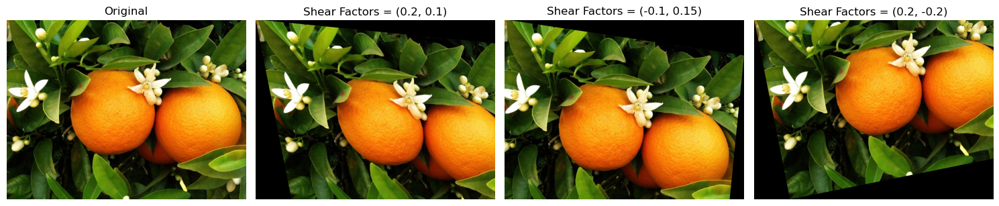

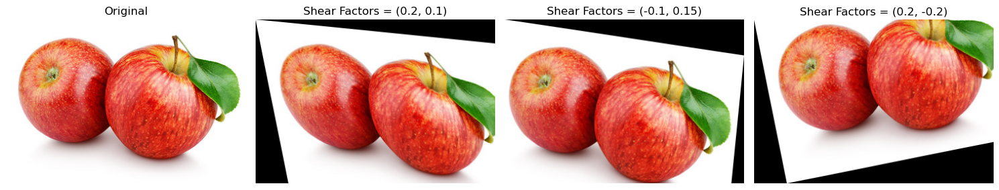

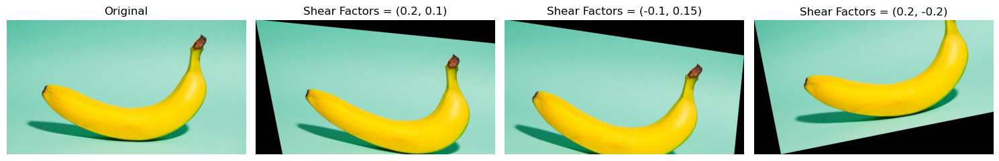

In [26]:
##### import cv2
import numpy as np
import matplotlib.pyplot as plt

def shear_image(image, shear_factor_x, shear_factor_y):
     """
    Shear an image
    :param image: Input image
    :param shear_factor_x: Shear factor in the x direction
    :param shear_factor_y: Shear factor in the y direction
    :return: Sheared image
    """
    rows, cols, _ = image.shape
    M = np.float32([[1, shear_factor_x, 0], [shear_factor_y, 1, 0]])
    sheared_image = cv2.warpAffine(image, M, (cols, rows))
    return sheared_image

# List of image files
img_files = ["orange_34.jpg", "apple_4.jpg", "banana_1.jpg"]

# Shear factors for each image
shear_factors = [(0.2, 0.1), (-0.1, 0.15), (0.2, -0.2)]

# Iterate over each image file
for idx, img_file in enumerate(img_files):
    original_image = cv2.imread(img_file)
    sheared_images = []

    # Apply shearing for different shear factors
    for shear_factor_x, shear_factor_y in shear_factors:
        sheared_image = shear_image(original_image.copy(), shear_factor_x=shear_factor_x, shear_factor_y=shear_factor_y)
        sheared_images.append(sheared_image)

    # Display and save the processed images
    fig, axes = plt.subplots(1, len(sheared_images) + 1, figsize=(15, 5))
    axes[0].imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))
    axes[0].set_title("Original")
    axes[0].axis('off')

    for i, sheared_image in enumerate(sheared_images, start=1):
        axes[i].imshow(cv2.cvtColor(sheared_image, cv2.COLOR_BGR2RGB))
        axes[i].set_title(f"Shear Factors = ({shear_factors[i-1][0]}, {shear_factors[i-1][1]})")
        axes[i].axis('off')

        # Save the sheared images
        shear_factors_str = f"{shear_factors[i-1][0]}_{shear_factors[i-1][1]}"
        output_filename = f"sheared_{img_file[:-4]}_{shear_factors_str}.jpg"
        cv2.imwrite(output_filename, sheared_image)

    plt.tight_layout()
    plt.show()


10. Cropping 

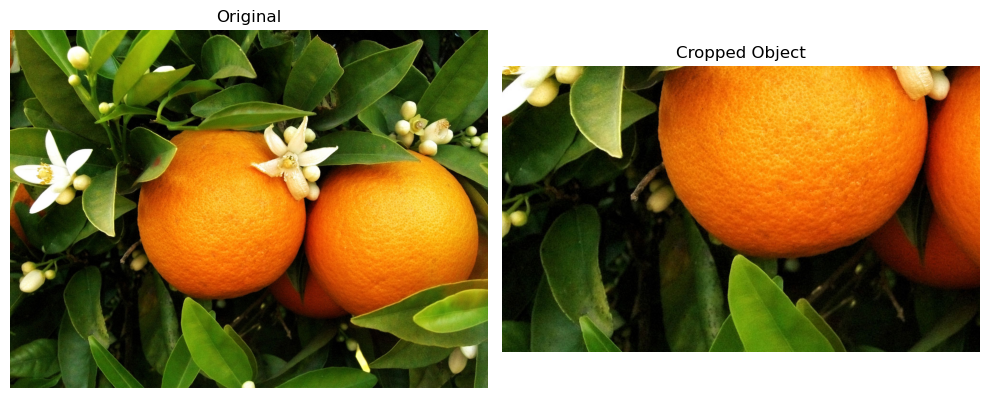

Saved cropped object image as cropped_object_orange_34.jpg


In [27]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def crop_object(image, x, y, width, height):
    cropped_image = image[y:y+height, x:x+width]
    return cropped_image

# List of image files
img_files = ["orange_34.jpg"]

# Object coordinates and dimensions for cropping
object_coords = [(100, 500, 1000, 600)]

# Iterate over each image file and object coordinates
for idx, img_file in enumerate(img_files):
    image = cv2.imread(img_file)

    object_x, object_y, object_width, object_height = object_coords[idx]

    # Crop object from image
    cropped_object = crop_object(image.copy(), object_x, object_y, object_width, object_height)

    # Display and save the cropped object images
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    axes[0].set_title("Original")
    axes[0].axis('off')

    axes[1].imshow(cv2.cvtColor(cropped_object, cv2.COLOR_BGR2RGB))
    axes[1].set_title("Cropped Object")
    axes[1].axis('off')

    plt.tight_layout()
    plt.show()

    # Save the cropped object image
    output_filename = f"cropped_object_{img_file[:-4]}.jpg"
    cv2.imwrite(output_filename, cropped_object)

    print(f"Saved cropped object image as {output_filename}")


11. Rotation

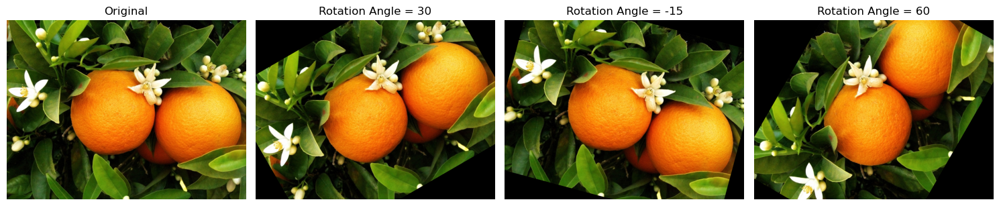

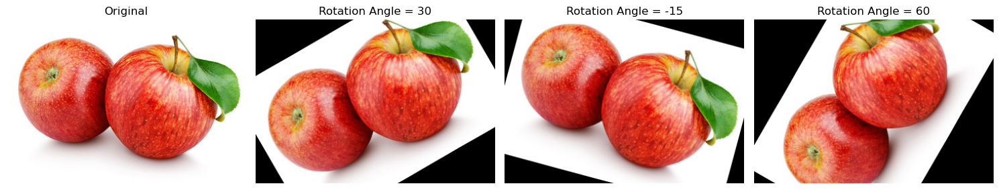

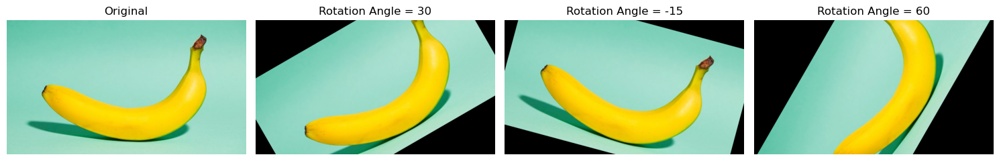

In [29]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def rotate_image(image, angle):
    """
    Rotate an image
    :param image: Input image
    :param angle: Rotation angle, positive values for counterclockwise rotation, negative values for clockwise rotation
    :return: Rotated image
    """
    rows, cols, _ = image.shape
    M = cv2.getRotationMatrix2D((cols / 2, rows / 2), angle, 1)
    rotated_image = cv2.warpAffine(image, M, (cols, rows))
    return rotated_image

# List of image files
img_files = ["orange_34.jpg", "apple_4.jpg", "banana_1.jpg"]

# Rotation angles for each image
rotation_angles = [30, -15, 60]

# Iterate over each image file
for idx, img_file in enumerate(img_files):
    original_image = cv2.imread(img_file)
    rotated_images = []

    # Apply rotation for different angles
    for angle in rotation_angles:
        rotated_image = rotate_image(original_image.copy(), angle=angle)
        rotated_images.append(rotated_image)

    # Display and save the processed images
    fig, axes = plt.subplots(1, len(rotated_images) + 1, figsize=(15, 5))
    axes[0].imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))
    axes[0].set_title("Original")
    axes[0].axis('off')

    for i, rotated_image in enumerate(rotated_images, start=1):
        axes[i].imshow(cv2.cvtColor(rotated_image, cv2.COLOR_BGR2RGB))
        axes[i].set_title(f"Rotation Angle = {rotation_angles[i-1]}")
        axes[i].axis('off')

        # Save the rotated images
        output_filename = f"rotated_{img_file[:-4]}_angle{i}.jpg"
        cv2.imwrite(output_filename, rotated_image)

    plt.tight_layout()
    plt.show()


12. Scaling

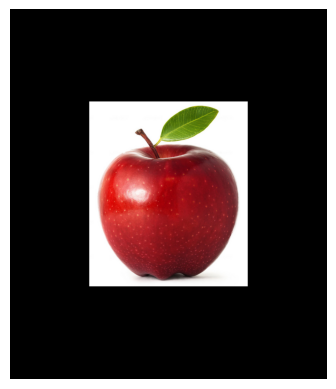

Processed image: apple_81.jpg


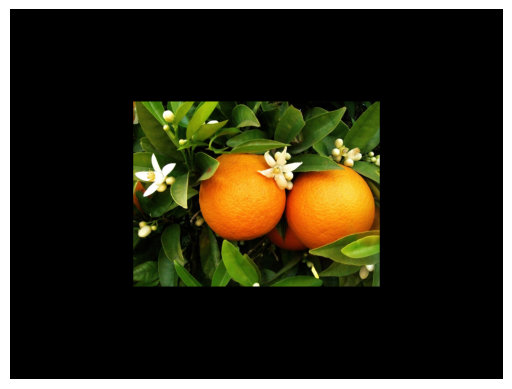

Processed image: orange_34.jpg


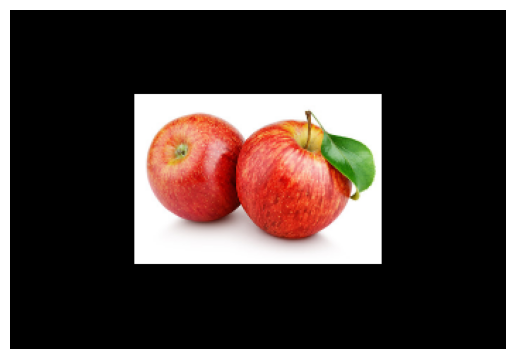

Processed image: apple_4.jpg


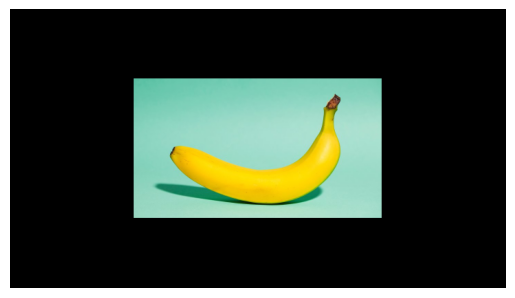

Processed image: banana_1.jpg
Resizing and centering on all images complete


In [36]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def resize_objects_center(img, scale_factor):
    """
    Scale an image
    :param image: Input image
    :param scale_factor: Scaling factor, greater than 1 for enlargement, less than 1 for reduction
    :return: Scaled image
    """
    h, w = img.shape[:2]
    scaled_h = int(h * scale_factor)
    scaled_w = int(w * scale_factor)

    scaled_img = cv2.resize(img, (scaled_w, scaled_h))

    top = (h - scaled_h) // 2
    bottom = h - scaled_h - top
    left = (w - scaled_w) // 2
    right = w - scaled_w - left

    padded_scaled_img = cv2.copyMakeBorder(scaled_img, top, bottom, left, right, cv2.BORDER_CONSTANT, value=(0, 0, 0))

    return padded_scaled_img

# List of image files
img_files = ["apple_81.jpg", "orange_34.jpg", "apple_4.jpg", "banana_1.jpg"]

scale_factor = 0.5  # Scaling factor for objects

# Iterate over each image file
for i, img_file in enumerate(img_files):
    img = cv2.imread(img_file)
    resized_centered_img = resize_objects_center(img, scale_factor)

    # Display the resized and centered image
    plt.imshow(cv2.cvtColor(resized_centered_img, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

    # Save the resized and centered image
    output_filename = f"resized_centered_{img_file}.jpg"
    cv2.imwrite(output_filename, resized_centered_img)

    print(f"Processed image: {img_file}")
    
print('Resizing and centering on all images complete')


13. Flipping

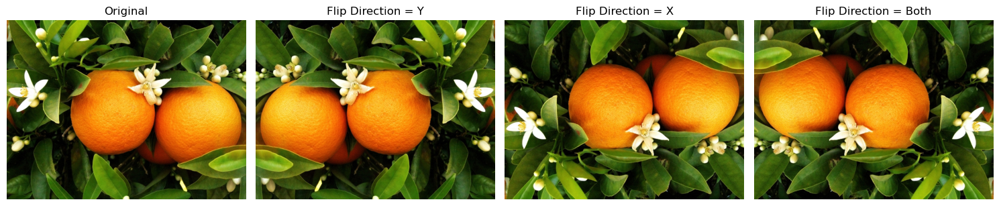

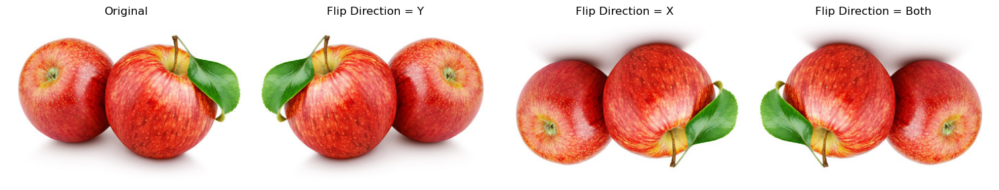

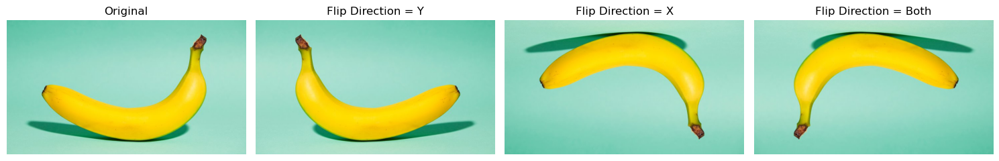

In [39]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def flip_image(image, flip_code):
    flipped_image = cv2.flip(image, flip_code)
    return flipped_image

# List of image files
img_files = ["orange_34.jpg", "apple_4.jpg", "banana_1.jpg"]

# Flip codes for each image (0: flip along x-axis, 1: flip along y-axis, -1: flip along both axes)
flip_codes = [1, 0, -1]

# Iterate over each image file
for idx, img_file in enumerate(img_files):
    """
    Flip an image
    :param image: Input image
    :param flip_code: Flip type, 0 for flipping around the x-axis, 
                      1 for flipping around the y-axis, -1 for flipping around both axes
    :return: Flipped image
    """
    original_image = cv2.imread(img_file)
    flipped_images = []

    # Apply flipping for different flip codes
    for flip_code in flip_codes:
        flipped_image = flip_image(original_image.copy(), flip_code=flip_code)
        flipped_images.append(flipped_image)

    # Display and save the processed images
    fig, axes = plt.subplots(1, len(flipped_images) + 1, figsize=(15, 5))
    axes[0].imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))
    axes[0].set_title("Original")
    axes[0].axis('off')

    for i, flipped_image in enumerate(flipped_images, start=1):
        axes[i].imshow(cv2.cvtColor(flipped_image, cv2.COLOR_BGR2RGB))
        flip_direction = "X" if flip_codes[i-1] == 0 else "Y" if flip_codes[i-1] == 1 else "Both"
        axes[i].set_title(f"Flip Direction = {flip_direction}")
        axes[i].axis('off')

        # Save the flipped images
        flip_direction_code = "x" if flip_codes[i-1] == 0 else "y" if flip_codes[i-1] == 1 else "both"
        output_filename = f"flipped_{img_file[:-4]}_{flip_direction_code}.jpg"
        cv2.imwrite(output_filename, flipped_image)

    plt.tight_layout()
    plt.show()


14. Image Splicing

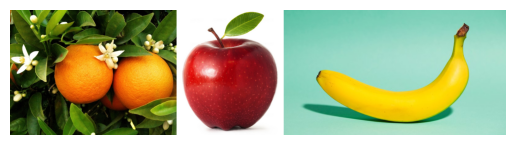

In [40]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Read three input images
image1 = cv2.imread("orange_34.jpg")
image2 = cv2.imread("apple_81.jpg")
image3 = cv2.imread("banana_1.jpg")

# Ensure all images have the same height
min_height = min(image1.shape[0], image2.shape[0], image3.shape[0])

# Resize images to have the same height
image1_resized = cv2.resize(image1, (int(image1.shape[1] * min_height / image1.shape[0]), min_height))
image2_resized = cv2.resize(image2, (int(image2.shape[1] * min_height / image2.shape[0]), min_height))
image3_resized = cv2.resize(image3, (int(image3.shape[1] * min_height / image3.shape[0]), min_height))

# Horizontally concatenate the resized images
concatenated_image = np.concatenate((image1_resized, image2_resized, image3_resized), axis=1)

# Save the concatenated image
cv2.imwrite('concatenated_image.jpg', concatenated_image)

# Display the concatenated image
plt.imshow(cv2.cvtColor(concatenated_image, cv2.COLOR_BGR2RGB))
plt.axis('off')  # Hide the axes
plt.show()


15. Occlusion

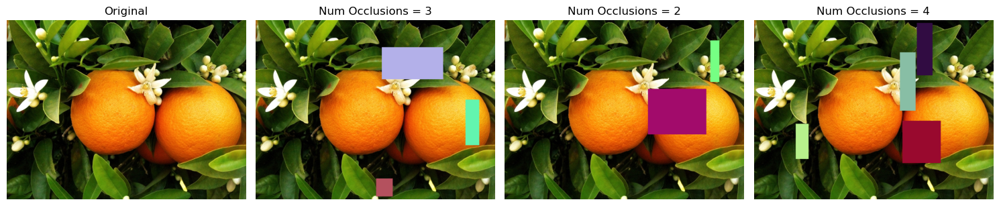

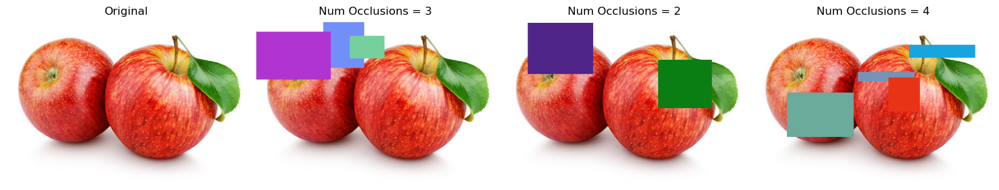

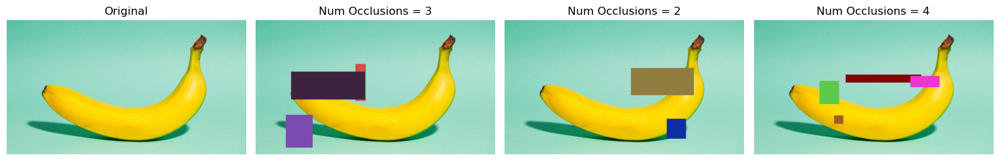

In [41]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def add_random_occlusion(image, num_occlusions):
    """
    Add random occlusions to an image.
    :param image: Input image.
    :param num_occlusions: Number of occlusions to add.
    :return: Image with occlusions.
    """
    h, w, _ = image.shape

    for _ in range(num_occlusions):
        occlusion_height = np.random.randint(10, h // 3)  # Occlusion height range
        occlusion_width = np.random.randint(10, w // 3)  # Occlusion width range

        # Randomly generate occlusion region position
        x1 = np.random.randint(0, w - occlusion_width)
        y1 = np.random.randint(0, h - occlusion_height)
        x2 = x1 + occlusion_width
        y2 = y1 + occlusion_height

        # Set occlusion region pixels to a random value (color or other values)
        random_color = np.random.randint(0, 256, (1, 1, 3), dtype=np.uint8)
        image[y1:y2, x1:x2] = random_color

    return image

# List of image files
img_files = ["orange_34.jpg", "apple_4.jpg", "banana_1.jpg"]

# Number of occlusions for each image
num_occlusions_list = [3, 2, 4]

# Iterate over each image file
for idx, img_file in enumerate(img_files):
    original_image = cv2.imread(img_file)
    images_with_occlusion = []

    # Apply occlusions for different numbers of occlusions
    for num_occlusions in num_occlusions_list:
        image_with_occlusion = add_random_occlusion(original_image.copy(), num_occlusions=num_occlusions)
        images_with_occlusion.append(image_with_occlusion)

    # Display and save the processed images
    fig, axes = plt.subplots(1, len(images_with_occlusion) + 1, figsize=(15, 5))
    axes[0].imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))
    axes[0].set_title("Original")
    axes[0].axis('off')

    for i, image_with_occlusion in enumerate(images_with_occlusion, start=1):
        axes[i].imshow(cv2.cvtColor(image_with_occlusion, cv2.COLOR_BGR2RGB))
        axes[i].set_title(f"Num Occlusions = {num_occlusions_list[i-1]}")
        axes[i].axis('off')

        # Save the images with occlusion
        output_filename = f"occlusion_{img_file[:-4]}_num_occlusions{i}.jpg"
        cv2.imwrite(output_filename, image_with_occlusion)

    plt.tight_layout()
    plt.show()


16. Cutout

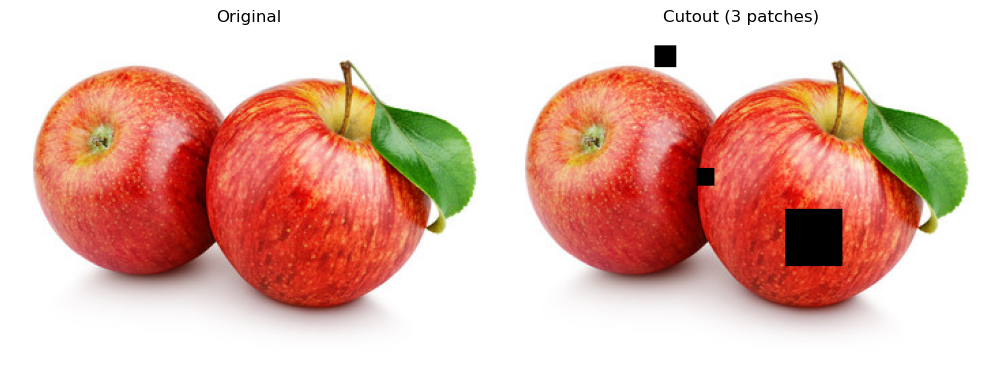

Saved Cutout image as cutout_apple_4.jpg


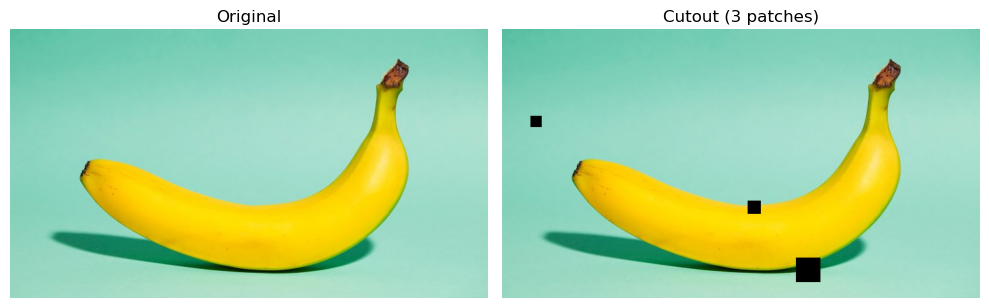

Saved Cutout image as cutout_banana_1.jpg


In [68]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import random

def cutout_image(image, num_patches, max_patch_size):
    """
    Apply Cutout augmentation to an image.
    :param image: Input image.
    :param num_patches: Number of patches to cut out.
    :param max_patch_size: Maximum size of each patch.
    :return: Image with Cutout applied.
    """
    h, w, _ = image.shape

    for _ in range(num_patches):
        patch_size = random.randint(1, max_patch_size)
        x1, y1 = random.randint(0, w - patch_size), random.randint(0, h - patch_size)
        x2, y2 = x1 + patch_size, y1 + patch_size

        image[y1:y2, x1:x2] = 0

    return image

# List of image files
img_files = ["apple_4.jpg", "banana_1.jpg"]

# Number of patches and maximum patch size for Cutout
num_patches = 3
max_patch_size = 50

# Iterate over each image file
for img_file in img_files:
    img = cv2.imread(img_file)

    # Apply Cutout augmentation
    cutout_img = cutout_image(img.copy(), num_patches=num_patches, max_patch_size=max_patch_size)

    # Display and save the processed images
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    axes[0].set_title("Original")
    axes[0].axis('off')

    axes[1].imshow(cv2.cvtColor(cutout_img, cv2.COLOR_BGR2RGB))
    axes[1].set_title(f"Cutout ({num_patches} patches)")
    axes[1].axis('off')

    plt.tight_layout()
    plt.show()

    # Save the Cutout image
    output_filename = f"cutout_{img_file[:-4]}.jpg"
    cv2.imwrite(output_filename, cutout_img)

    print(f"Saved Cutout image as {output_filename}")


17. Cutmix

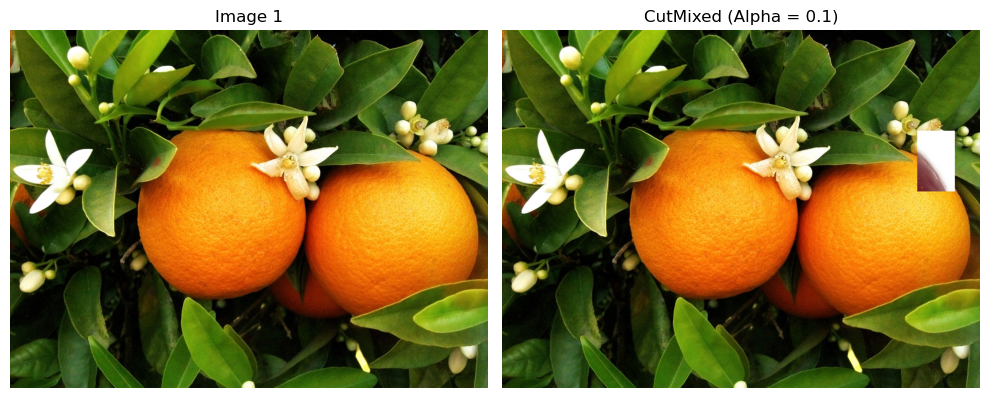

Saved CutMixed image as cutmixed_orange_34_apple_81.jpg


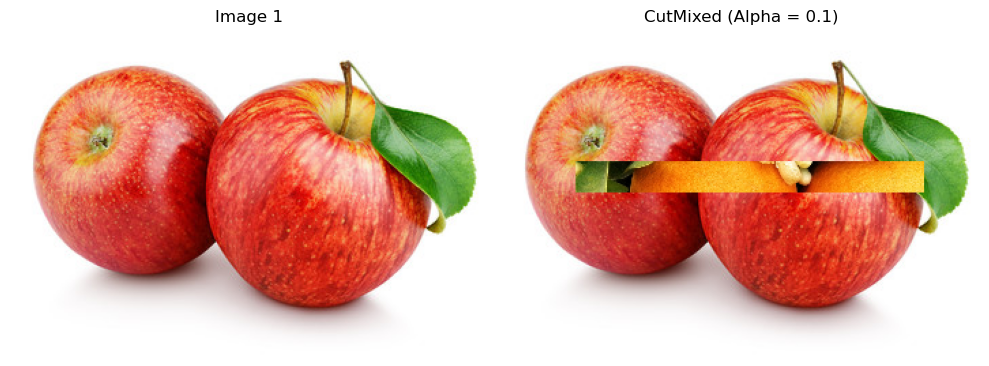

Saved CutMixed image as cutmixed_apple_4_orange_34.jpg


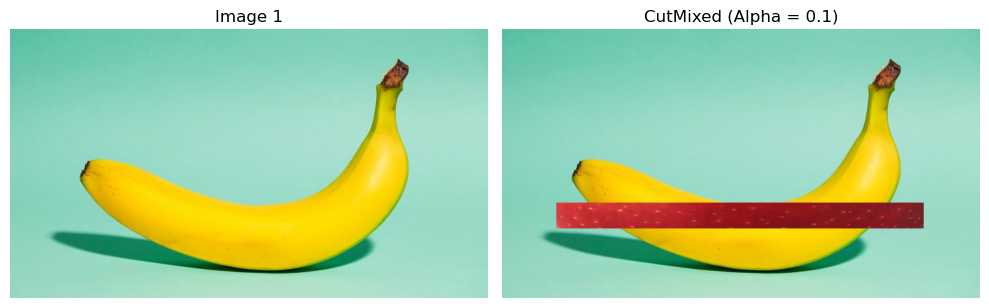

Saved CutMixed image as cutmixed_banana_1_apple_81.jpg


In [43]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import random

def cutmix_images(image1, image2, alpha):
    h, w, _ = image1.shape
    x1, y1 = random.randint(0, w), random.randint(0, h)
    x2, y2 = random.randint(0, w), random.randint(0, h)
    x1, x2 = min(x1, x2), max(x1, x2)
    y1, y2 = min(y1, y2), max(y1, y2)

    mixed_image = image1.copy()
    mixed_image[y1:y2, x1:x2] = image2[y1:y2, x1:x2]

    return mixed_image

# List of image pairs to perform CutMix
image_pairs = [("orange_34.jpg", "apple_81.jpg"), 
               ("apple_4.jpg", "orange_34.jpg"), 
               ("banana_1.jpg", "apple_81.jpg")]

# Set CutMix weight alpha
alpha = 0.1

# Iterate over each image pair
for idx, (image1_path, image2_path) in enumerate(image_pairs):
    image1 = cv2.imread(image1_path)
    image2 = cv2.imread(image2_path)

    # Make sure both images have the same size
    image2 = cv2.resize(image2, (image1.shape[1], image1.shape[0]))

    # Perform CutMix operation
    cutmixed_image = cutmix_images(image1.copy(), image2.copy(), alpha)

    # Display and save the CutMix images
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].imshow(cv2.cvtColor(image1, cv2.COLOR_BGR2RGB))
    axes[0].set_title("Image 1")
    axes[0].axis('off')

    axes[1].imshow(cv2.cvtColor(cutmixed_image, cv2.COLOR_BGR2RGB))
    axes[1].set_title(f"CutMixed (Alpha = {alpha})")
    axes[1].axis('off')

    plt.tight_layout()
    plt.show()

    # Save the CutMix image
    output_filename = f"cutmixed_{image1_path[:-4]}_{image2_path[:-4]}.jpg"
    cv2.imwrite(output_filename, cutmixed_image)

    print(f"Saved CutMixed image as {output_filename}")


18. Mixup

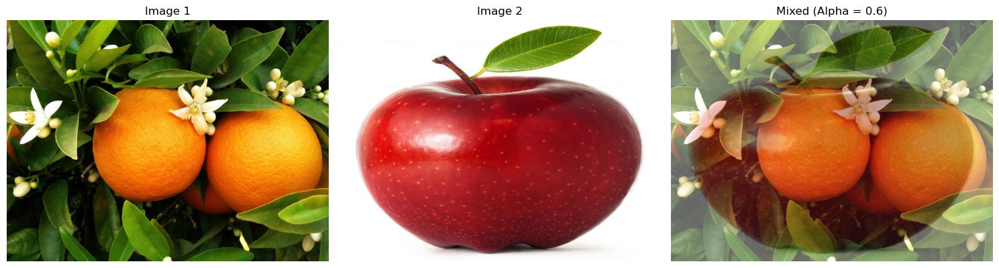

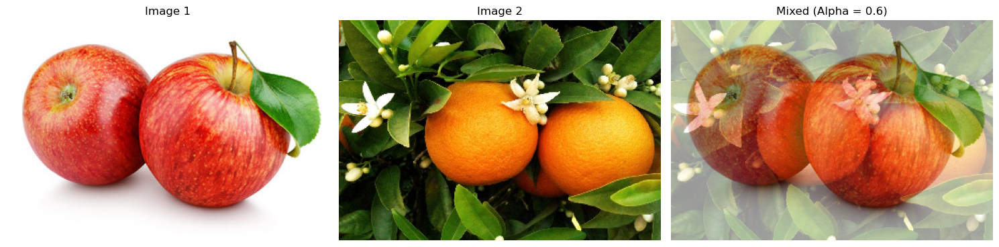

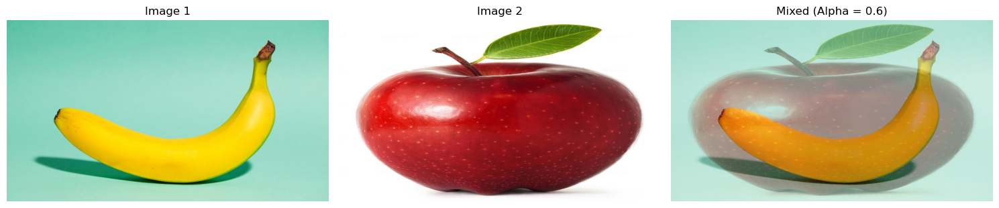

In [42]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def mixup_images(image1, image2, alpha):
    """
    Perform MixUp operation on two images
    :param image1: Image 1
    :param image2: Image 2
    :param alpha: MixUp weight, should be in the range [0, 1]
    :return: Mixed image
    """
    mixed_image = cv2.addWeighted(image1, alpha, image2, 1 - alpha, 0)
    return mixed_image

# List of image pairs to mix
image_pairs = [("orange_34.jpg", "apple_81.jpg"), 
               ("apple_4.jpg", "orange_34.jpg"), 
               ("banana_1.jpg", "apple_81.jpg")]

# Set MixUp weight alpha
alpha = 0.6

# Iterate over each image pair
for idx, (image1_path, image2_path) in enumerate(image_pairs):
    image1 = cv2.imread(image1_path)
    image2 = cv2.imread(image2_path)

    # Make sure both images have the same size
    image2 = cv2.resize(image2, (image1.shape[1], image1.shape[0]))

    # Perform MixUp operation
    mixed_image = mixup_images(image1.copy(), image2.copy(), alpha=alpha)

    # Display and save the mixed images
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    axes[0].imshow(cv2.cvtColor(image1, cv2.COLOR_BGR2RGB))
    axes[0].set_title("Image 1")
    axes[0].axis('off')

    axes[1].imshow(cv2.cvtColor(image2, cv2.COLOR_BGR2RGB))
    axes[1].set_title("Image 2")
    axes[1].axis('off')

    axes[2].imshow(cv2.cvtColor(mixed_image, cv2.COLOR_BGR2RGB))
    axes[2].set_title(f"Mixed (Alpha = {alpha})")
    axes[2].axis('off')

    plt.tight_layout()
    plt.show()

    # Save the mixed image
    output_filename = f"mixed_{image1_path[:-4]}_{image2_path[:-4]}.jpg"
    cv2.imwrite(output_filename, mixed_image)
